In [1]:
#!pip install tensorflow_datasets|

In [22]:
import tensorflow_datasets as tfds
import tensorflow as tf
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm
import seaborn as sns
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import normalize
tfds.disable_progress_bar()

In [34]:
(train_ds, validation_ds), info_data = tfds.load(
    "emnist/bymerge",
    split=["train[:85%]", "train[85%:]"],
    as_supervised=False,
    with_info = True,
    shuffle_files=True
)

In [35]:
print(info_data)

tfds.core.DatasetInfo(
    name='emnist',
    version=3.0.0,
    description='The EMNIST dataset is a set of handwritten character digits derived from the NIST Special Database 19 and converted to a 28x28 pixel image format and dataset structure that directly matches the MNIST dataset.

Note: Like the original EMNIST data, images provided here are inverted horizontally and rotated 90 anti-clockwise. You can use `tf.transpose` within `ds.map` to convert the images to a human-friendlier format.',
    homepage='https://www.nist.gov/itl/products-and-services/emnist-dataset',
    features=FeaturesDict({
        'image': Image(shape=(28, 28, 1), dtype=tf.uint8),
        'label': ClassLabel(shape=(), dtype=tf.int64, num_classes=47),
    }),
    total_num_examples=814255,
    splits={
        'test': 116323,
        'train': 697932,
    },
    supervised_keys=('image', 'label'),
    citation="""@article{cohen_afshar_tapson_schaik_2017,
        title={EMNIST: Extending MNIST to handwritten lett

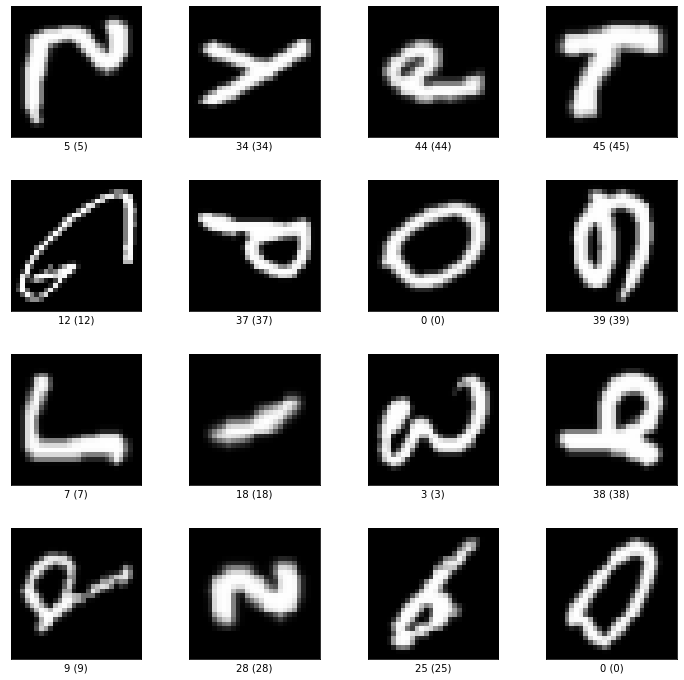

In [36]:
fig = tfds.show_examples(train_ds , info_data , rows=4 , cols = 4)

In [4]:
LABELS = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 
          'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z',
          'a', 'b', 'd', 'e', 'f', 'g', 'h', 'n', 'q', 'r', 't']

print(len(LABELS))

47


In [5]:
AUTO = tf.data.experimental.AUTOTUNE 
BATCH_SIZE = 128

## We are transposing to rotate the image by 90 deg clockwise making the images human friendly.
def transpose_and_flatten(image, label):
    image = tf.image.convert_image_dtype(image, dtype=tf.float32) # scale image pixels to [0,1]
    image = tf.transpose(image, [1,0,2]) # transpose to get human friendly image, since rotation
    image = tf.reshape(image, shape=(784,)) # permutation invariant or flatten 
    label = tf.one_hot(label, depth=len(LABELS)) # one hot encode label

    return image, label

trainloader = (
    train_ds
    .shuffle(1024)
    .map(transpose_and_flatten, num_parallel_calls=AUTO)
    .batch(BATCH_SIZE)
    .prefetch(AUTO)
)

testloader = (
    validation_ds
    .map(transpose_and_flatten, num_parallel_calls=AUTO)
    .batch(BATCH_SIZE)
    .prefetch(AUTO)
)

In [6]:
trainloader

<PrefetchDataset shapes: ((None, 784), (None, 47)), types: (tf.float32, tf.float32)>

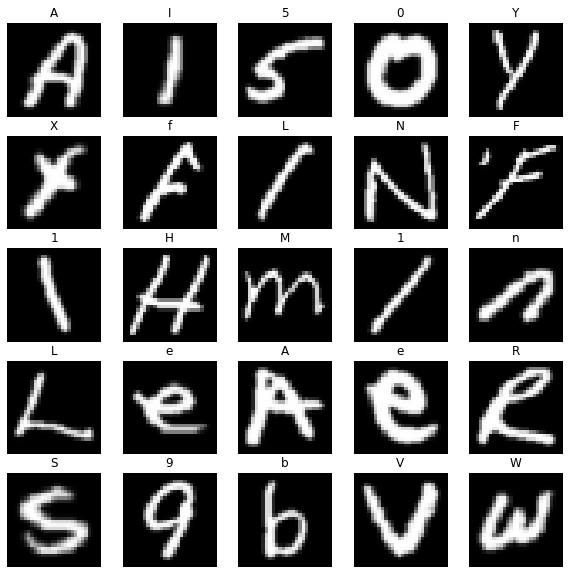

In [7]:
import matplotlib.pyplot as plt
import numpy as np
imgs, labels = next(iter(trainloader))

plt.figure(figsize=(10, 10))
for n in range(25):
    ax = plt.subplot(5, 5, n+1)
    plt.imshow(tf.reshape(imgs[n], shape=(28,28)), cmap='gray')
    plt.title(LABELS[np.argmax(labels[n])])
    plt.axis('off')

In [8]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense , Dropout
from tensorflow.keras.callbacks import EarlyStopping

In [12]:
import wandb
from wandb.keras import WandbCallback

wandb.login()
wandb.init(entity='iit-bhu', project='emnist',name='drishtant_rai-19154010')

wandb: Currently logged in as: drishtant-iit (use `wandb login --relogin` to force relogin)
wandb: wandb version 0.10.1 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade
wandb: Tracking run with wandb version 0.10.0
wandb: Run data is saved locally in wandb/run-20200918_112831-3k1rgvxg
wandb: Syncing run drishtant_rai-19154010


In [13]:
model = Sequential()
#hidden layer
model.add(Dense(units=784, activation='relu', input_dim = 784))
model.add(Dense(units=392, activation='relu'))
model.add(Dense(units=92, activation='relu'))
#output layer
model.add(Dense(units=47,activation="softmax"))

early_stop = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', patience=5, verbose=0, mode='auto', restore_best_weights=True
)

In [14]:
model.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['acc'])

In [15]:
model.fit(trainloader,epochs=10, batch_size=256,validation_data=testloader,)

Epoch 1/10
4635/4635 [==============================] - 55s 12ms/step - loss: 0.4921 - acc: 0.8374 - val_loss: 0.3875 - val_acc: 0.8645
Epoch 2/10
4635/4635 [==============================] - 59s 13ms/step - loss: 0.3454 - acc: 0.8771 - val_loss: 0.3461 - val_acc: 0.8766
Epoch 3/10
4635/4635 [==============================] - 58s 12ms/step - loss: 0.3119 - acc: 0.8865 - val_loss: 0.3438 - val_acc: 0.8774
Epoch 4/10
4635/4635 [==============================] - 60s 13ms/step - loss: 0.2897 - acc: 0.8928 - val_loss: 0.3384 - val_acc: 0.8807
Epoch 5/10
4635/4635 [==============================] - 58s 13ms/step - loss: 0.2742 - acc: 0.8971 - val_loss: 0.3489 - val_acc: 0.8793
Epoch 6/10
4635/4635 [==============================] - 61s 13ms/step - loss: 0.2616 - acc: 0.9005 - val_loss: 0.3521 - val_acc: 0.8823
Epoch 7/10
4635/4635 [==============================] - 66s 14ms/step - loss: 0.2529 - acc: 0.9027 - val_loss: 0.3604 - val_acc: 0.8799
Epoch 8/10
4635/4635 [==========================

In [26]:
performance = pd.DataFrame(model.history.history)

In [27]:
import cufflinks as cf
cf.go_offline()

In [28]:
performance.iplot()

In [16]:
model.save('Emnist_Ann_model_relu.h5')

In [18]:
model = Sequential()
model.add(Dense(512, input_shape=(784,),activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(512,activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(512,activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(47,activation='softmax'))
model.compile(loss='categorical_crossentropy', metrics=['accuracy'], optimizer='adam')

In [19]:
# early_stop = tf.keras.callbacks.EarlyStopping(
#     monitor='val_loss', patience=5, verbose=0, mode='auto', restore_best_weights=True
# )
# model.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['acc'])
model.fit(trainloader,epochs=18, batch_size=128,validation_data=testloader,callbacks=[WandbCallback()])

Epoch 1/18
4635/4635 [==============================] - 55s 12ms/step - loss: 0.5710 - accuracy: 0.8146 - val_loss: 0.3790 - val_accuracy: 0.8666
Epoch 2/18
4635/4635 [==============================] - 55s 12ms/step - loss: 0.4264 - accuracy: 0.8548 - val_loss: 0.3615 - val_accuracy: 0.8708
Epoch 3/18
4635/4635 [==============================] - 56s 12ms/step - loss: 0.4003 - accuracy: 0.8623 - val_loss: 0.3502 - val_accuracy: 0.8739
Epoch 4/18
4635/4635 [==============================] - 55s 12ms/step - loss: 0.3881 - accuracy: 0.8660 - val_loss: 0.3403 - val_accuracy: 0.8792
Epoch 5/18
4635/4635 [==============================] - 56s 12ms/step - loss: 0.3797 - accuracy: 0.8685 - val_loss: 0.3349 - val_accuracy: 0.8799
Epoch 6/18
4635/4635 [==============================] - 56s 12ms/step - loss: 0.3743 - accuracy: 0.8705 - val_loss: 0.3342 - val_accuracy: 0.8827
Epoch 7/18
4635/4635 [==============================] - 55s 12ms/step - loss: 0.3700 - accuracy: 0.8718 - val_loss: 0.3358 -

In [22]:
def plot_confusion_matrix():
    y_test = []
    y_preds = []
    for imgs, labels in tqdm(testloader):
        y_test.extend(np.argmax(labels, axis=1))
        y_pred = model.predict(imgs)
        y_preds.extend(np.argmax(y_pred, axis=1))

        cm = confusion_matrix(y_true = y_test, y_pred = y_preds)
        cm_normalize = normalize(cm, axis=1)

        plt.figure(figsize=(15,15));
        sns.heatmap(cm_normalize, annot=False, xticklabels=LABELS, yticklabels=LABELS, linewidths=.1);

        plt.savefig('confusion_matrix.png', bbox_inches='tight')

20it [00:09,  2.01it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

21it [00:10,  2.02it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

22it [00:10,  2.03it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

23it [00:1

45it [00:22,  1.98it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

46it [00:23,  1.95it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

47it [00:23,  1.95it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

48it [00:2

70it [00:36,  1.57it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

71it [00:36,  1.57it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

72it [00:37,  1.26it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

73it [00:3

95it [00:50,  1.95it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

96it [00:50,  1.99it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

97it [00:51,  1.96it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

98it [00:5

120it [01:03,  2.02it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

121it [01:04,  2.02it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

122it [01:04,  2.04it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

123it [

145it [01:16,  1.98it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

146it [01:17,  1.98it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

147it [01:17,  1.98it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

148it [

170it [01:29,  1.95it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

171it [01:29,  1.95it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

172it [01:30,  1.96it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

173it [

195it [01:43,  1.89it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

196it [01:43,  1.91it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

197it [01:44,  1.92it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

198it [

220it [01:57,  1.39it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

221it [01:58,  1.35it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

222it [01:59,  1.31it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

223it [

245it [02:14,  1.50it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

246it [02:14,  1.53it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

247it [02:15,  1.62it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

248it [

270it [02:28,  1.84it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

271it [02:29,  1.83it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

272it [02:29,  1.83it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

273it [

295it [02:43,  1.82it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

296it [02:44,  1.86it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

297it [02:44,  1.89it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

298it [

320it [02:57,  1.84it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

321it [02:57,  1.84it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

322it [02:58,  1.86it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

323it [

345it [03:11,  1.75it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

346it [03:12,  1.74it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

347it [03:12,  1.70it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

348it [

370it [03:29,  1.46it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

371it [03:30,  1.53it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

372it [03:30,  1.53it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

373it [

395it [03:45,  1.60it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

396it [03:45,  1.61it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

397it [03:46,  1.63it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

398it [

420it [04:00,  1.76it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

421it [04:01,  1.77it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

422it [04:01,  1.75it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

423it [

445it [04:15,  1.40it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

446it [04:16,  1.36it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

447it [04:17,  1.39it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

448it [

470it [04:33,  1.79it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

471it [04:33,  1.73it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

472it [04:34,  1.68it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

473it [

495it [04:48,  1.73it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

496it [04:48,  1.74it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

497it [04:49,  1.73it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

498it [

520it [05:04,  1.67it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

521it [05:05,  1.69it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

522it [05:05,  1.71it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

523it [

545it [05:19,  1.69it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

546it [05:19,  1.72it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

547it [05:20,  1.73it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

548it [

570it [05:35,  1.12s/it]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

571it [05:36,  1.04it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

572it [05:37,  1.19it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

573it [

595it [05:50,  1.74it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

596it [05:51,  1.74it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

597it [05:51,  1.73it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

598it [

620it [06:04,  1.73it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

621it [06:05,  1.74it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

622it [06:06,  1.74it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

623it [

645it [06:19,  1.72it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

646it [06:20,  1.73it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

647it [06:20,  1.72it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

648it [

670it [06:34,  1.69it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

671it [06:34,  1.72it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

672it [06:35,  1.74it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

673it [

695it [06:48,  1.73it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

696it [06:49,  1.69it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

697it [06:50,  1.66it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

698it [

720it [07:06,  1.58it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

721it [07:07,  1.61it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

722it [07:08,  1.64it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

723it [

745it [07:22,  1.60it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

746it [07:22,  1.54it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

747it [07:23,  1.55it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

748it [

770it [07:38,  1.59it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

771it [07:38,  1.60it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

772it [07:39,  1.60it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

773it [

795it [07:55,  1.52it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

796it [07:55,  1.53it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

797it [07:56,  1.51it/s]<ipython-input-22-f1e9bfa3dc3b>:12: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

798it [

KeyboardInterrupt: 

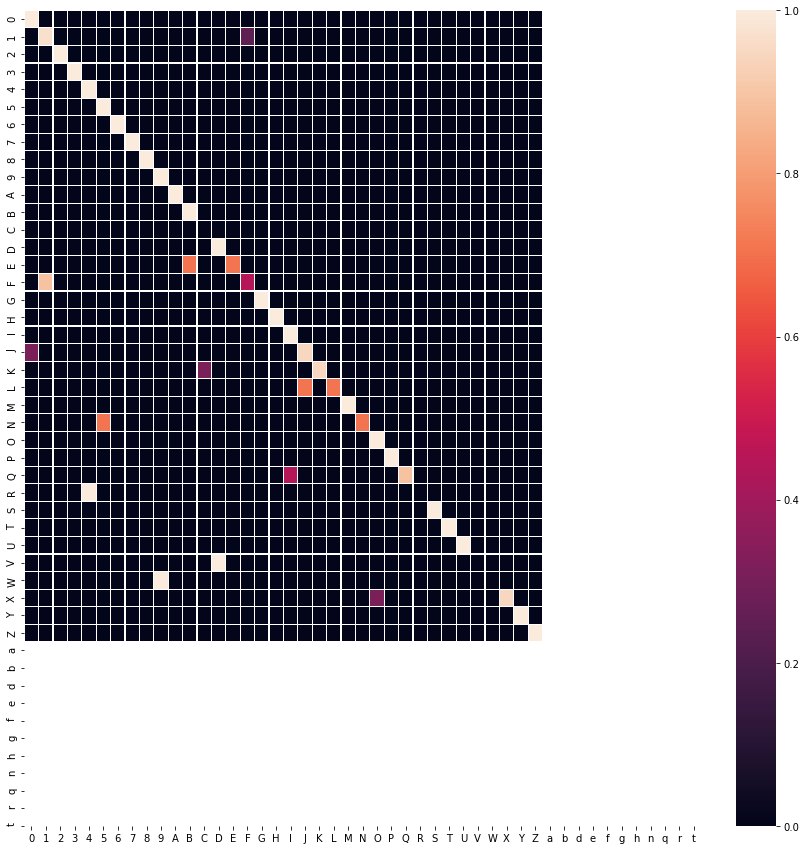

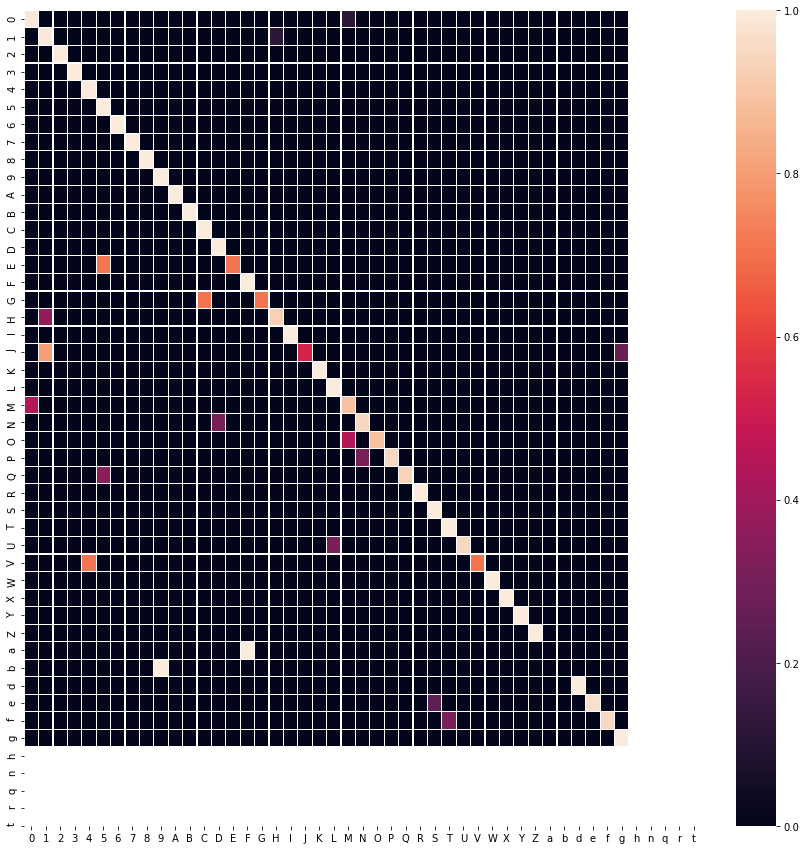

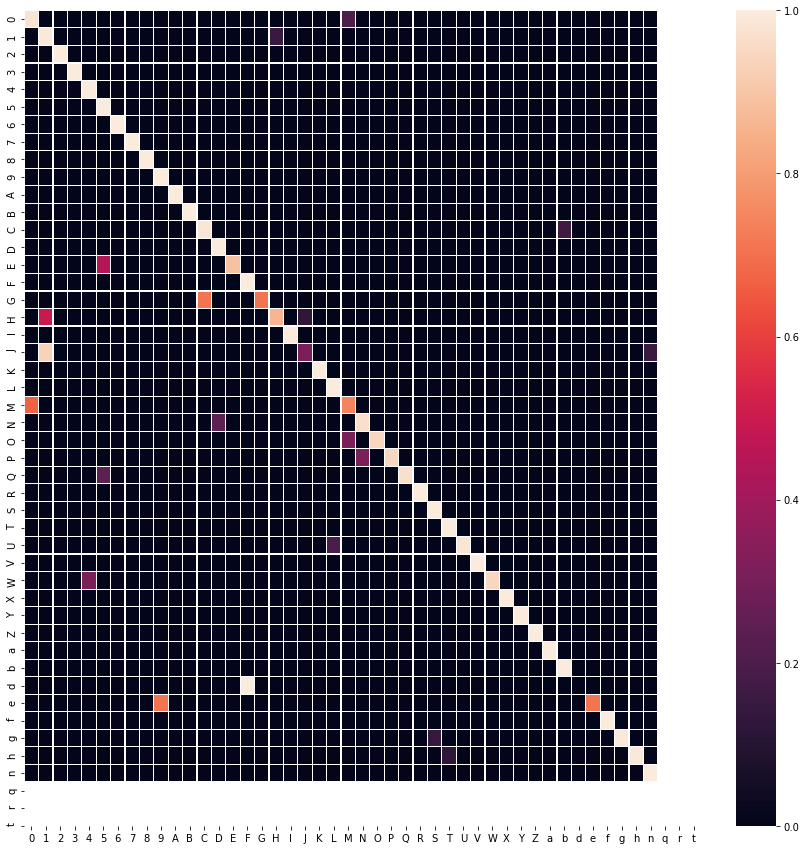

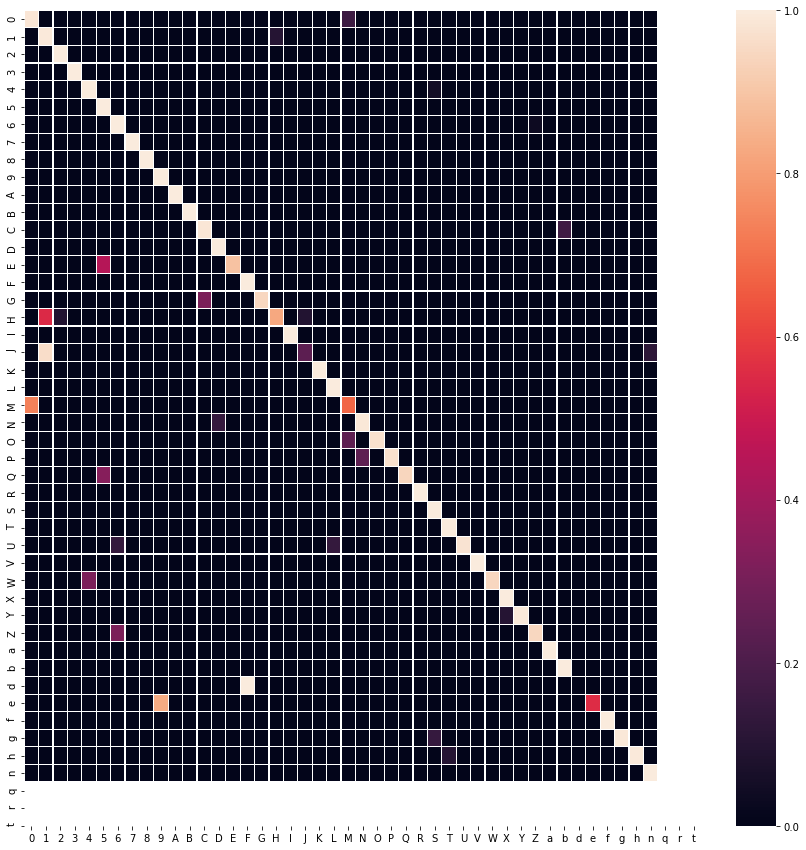

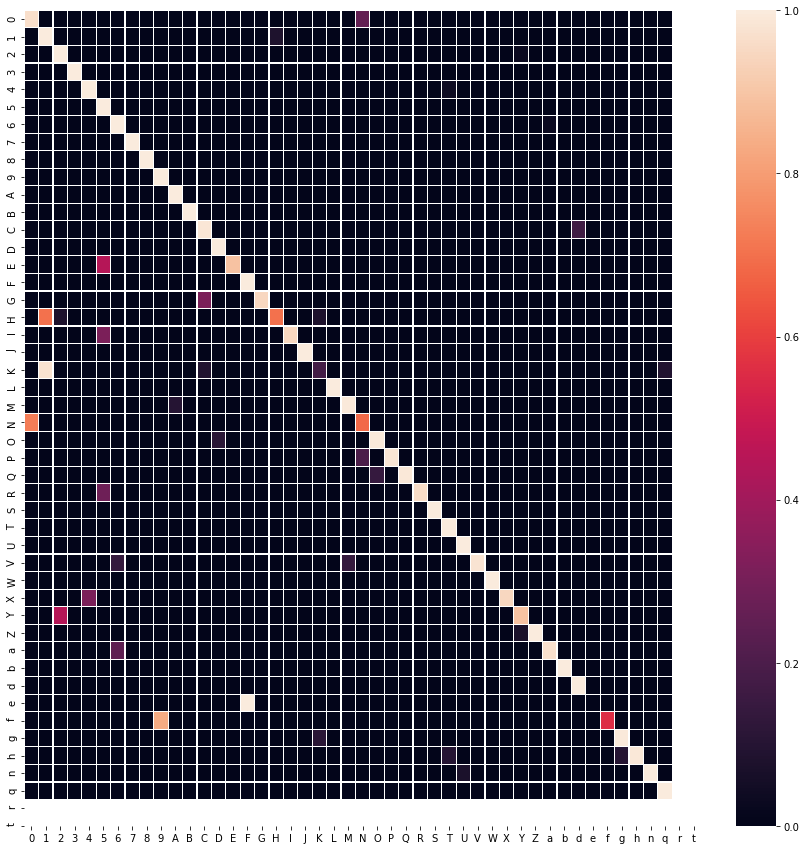

...

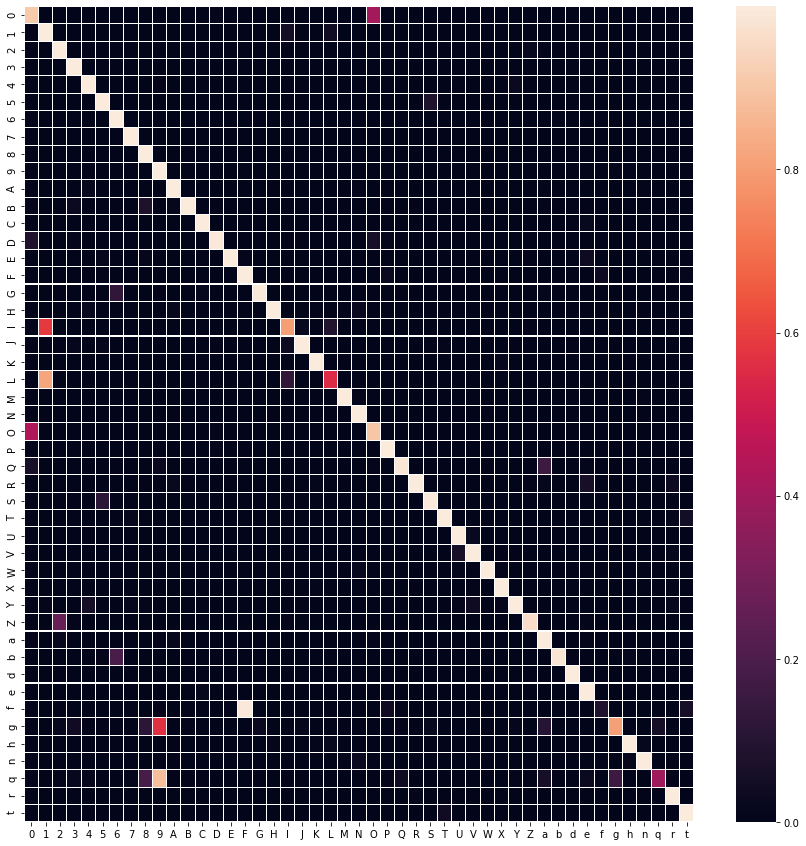

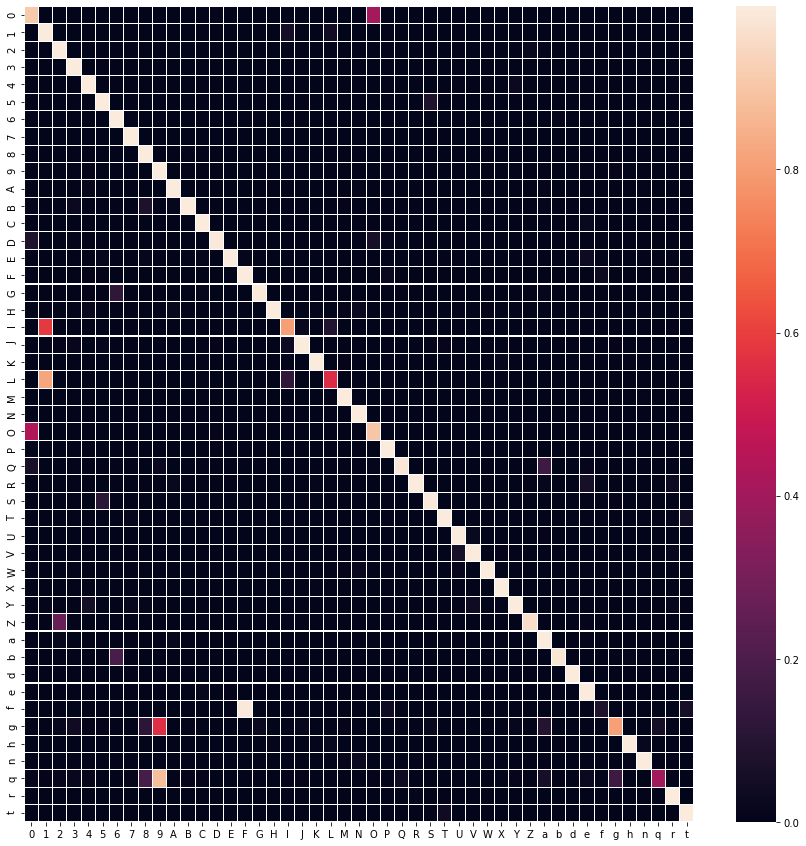

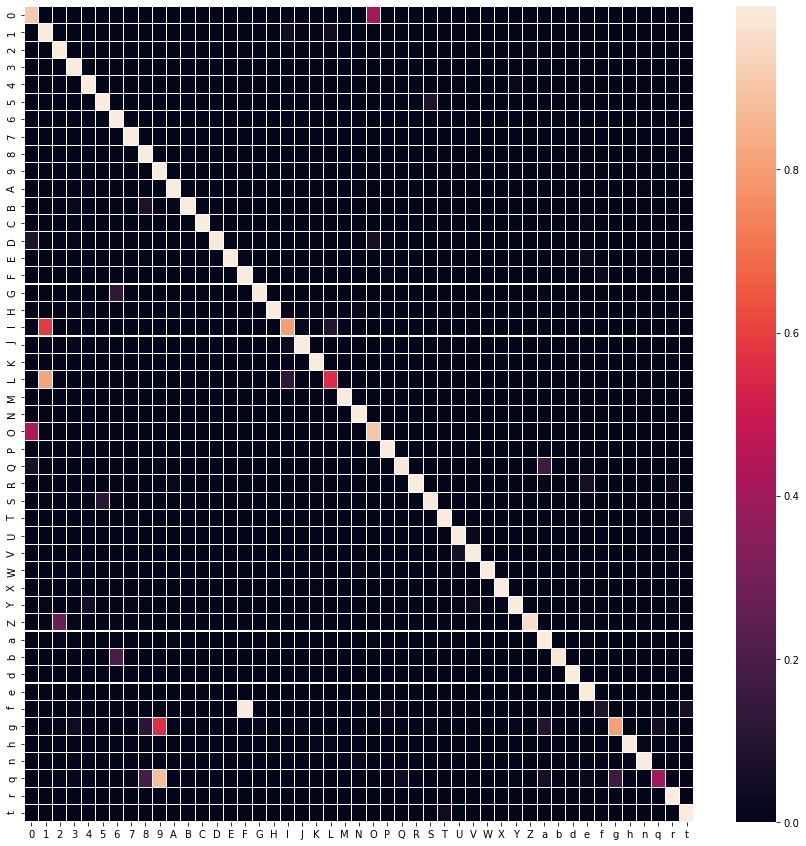

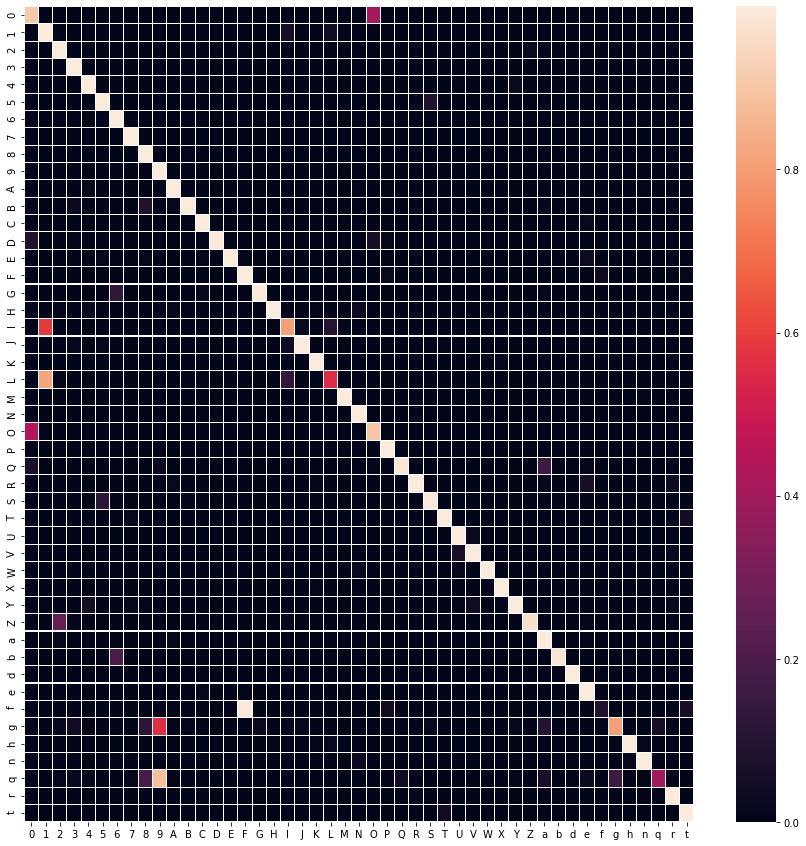

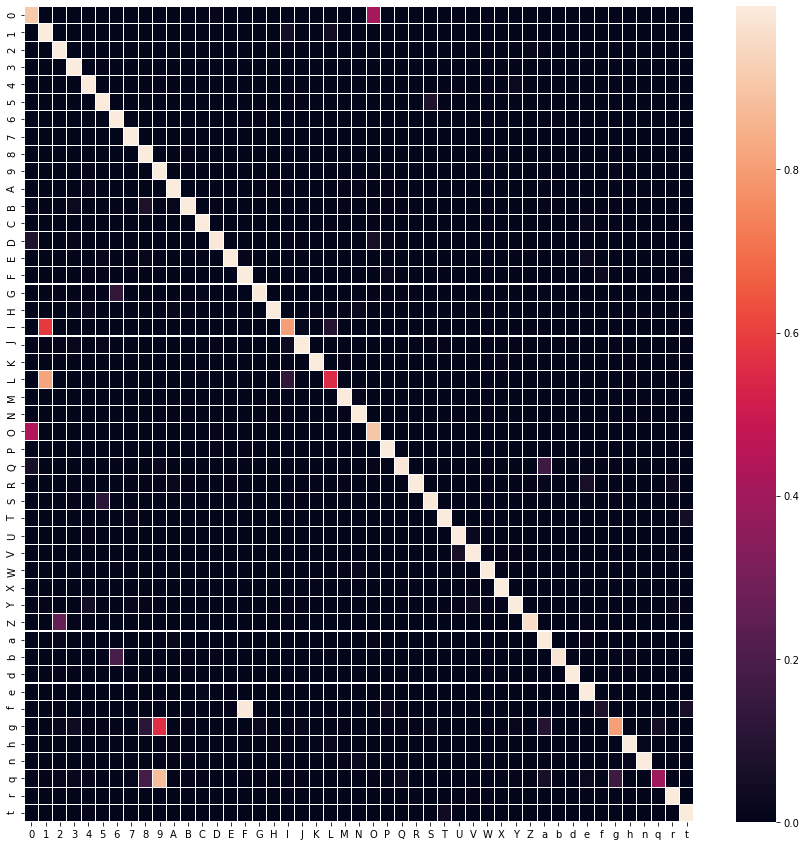

<Figure size 1080x1080 with 0 Axes>

In [ ]:
plot_confusion_matrix()

In [20]:
import emnist

In [ ]:
from emnist import 